# Exploring 2019 Bologna Encuesta data - Trips (Viajes)

In [1]:
# Read Viajesmex data
file_path = '../data/input/encuesta-19/ViajesEODH2019.csv'
import pandas as pd


# one-off exploration and cleaning

In [2]:

# Only need to do this once: 
# order by id_hogar, then id_persona, then id_viaje, and save to the same file
# viajes = pd.read_csv(file_path, sep=';', encoding='latin1')
# viajes = viajes.sort_values(by=['id_hogar', 'id_persona', 'id_viaje'])
# viajes.to_csv(file_path, sep=';', encoding='latin1', index=False)

viajes = pd.read_csv(file_path, sep=';', encoding='latin1')
viajes.p29_id_municipio.value_counts() # maybe subset to value 11001 for city center only?
viajes.modo_principal.value_counts() # filter for this being TransMilenio only? 
viajes[viajes.modo_principal == "TransMilenio"].modo_principal_desagregado.value_counts() # no more futher subtypes


/tmp/ipykernel_309014/2566620573.py:7: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  viajes = pd.read_csv(file_path, sep=';', encoding='latin1')


modo_principal_desagregado
TransMilenio    16589
Name: count, dtype: int64

In [3]:
viajes

,id_hogar,id_persona,id_viaje,fecha,lugar_origen,zat_origen,p17_Id_motivo_viaje,p17_otro_motivo,hora_inicio_viaje,p28_lugar_destino,...,p34_cual_aplicacion_durante_viaje,p35_otro_desplazamiento,p36_hora_salida,f_exp,mun_origen,mun_destino,utam_origen,utam_destino,modo_principal,modo_principal_desagregado
0,10001,1,1,43587.0,1.0,379.0,5,NaN,0.562500,2.0,...,NaN,1.0,0.750000,208.504022,11001.0,11001.0,UTAM43,UTAM85,SITP Zonal,SITP - Urbano (Azul)
1,10001,1,2,43587.0,2.0,947.0,6,NaN,0.750000,1.0,...,NaN,2.0,NaN,208.504022,11001.0,11001.0,UTAM85,UTAM43,SITP Provisional,SITP - Provisional
2,10001,2,1,43587.0,1.0,379.0,1,NaN,0.333333,2.0,...,MOOVIT,1.0,0.750000,208.504022,11001.0,11001.0,UTAM43,UTAM107,SITP Zonal,SITP - Urbano (Azul)
3,10001,2,2,43587.0,2.0,334.0,6,NaN,0.750000,1.0,...,NaN,2.0,NaN,208.504022,11001.0,11001.0,UTAM107,UTAM43,SITP Zonal,SITP - Urbano (Azul)
4,10003,1,1,43586.0,1.0,1036.0,10,NaN,0.375000,2.0,...,NaN,1.0,0.541667,36.267857,11001.0,11001.0,UTAM2,UTAM10,SITP Zonal,SITP - Urbano (Azul)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134492,P08712,3,3,43673.0,2.0,259.0,6,NaN,0.729167,1.0,...,NaN,2.0,NaN,73.292184,11001.0,11001.0,UTAM97,UTAM88,Auto,VehÃ­culo privado como pasajero
134493,P08712,4,1,NaN,NaN,NaN,3,NaN,0.270833,NaN,...,NaN,NaN,0.635417,73.292184,NaN,NaN,NaN,NaN,Transporte Escolar,Transporte escolar
134494,P08712,4,2,NaN,NaN,NaN,6,NaN,0.635417,NaN,...,NaN,NaN,NaN,73.292184,NaN,NaN,NaN,NaN,Transporte Escolar,Transporte escolar
134495,P08715,1,1,43676.0,1.0,150.0,1,NaN,0.291667,2.0,...,NaN,1.0,0.437500,112.386068,11001.0,11001.0,UTAM14,UTAM111,Auto,VehÃ­culo privado como conductor


# Read data

In [3]:
# Create OD-matrix using origin locations (zat_origen) and destination location (zat_destino)
# OD Matrix
viajes = pd.read_csv(file_path, sep=';', encoding='latin1')
viajes = viajes[viajes.modo_principal == "TransMilenio"]
viajes = viajes[viajes.p29_id_municipio == 11001] # filter for city center only?
viajes = viajes[viajes.zat_origen != 0] # filter out missing origin
viajes = viajes[viajes.zat_destino != 0] # filter out missing destination
od_matrix = viajes.groupby(['zat_origen', 'zat_destino']).size().reset_index(name='journey_count')
print(od_matrix)

# Origin journeys
origin_journeys = viajes.groupby(['zat_origen']).size().reset_index(name='journey_count')

# Destination journeys
destination_journeys = viajes.groupby(['zat_destino']).size().reset_index(name='journey_count')

       zat_origen  zat_destino  journey_count
0             1.0        669.0              2
1             3.0        506.0              1
2             4.0         64.0              1
3             4.0        167.0              1
4             4.0        187.0              1
...           ...          ...            ...
13595      1902.0        753.0              1
13596      1903.0        114.0              1
13597      1903.0        180.0              1
13598      1903.0       1028.0              1
13599      1905.0        410.0              1

[13600 rows x 3 columns]


/tmp/ipykernel_309014/2150272838.py:3: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  viajes = pd.read_csv(file_path, sep=';', encoding='latin1')


In [4]:
# combine with a shapefile to obtain the coordinates
import geopandas as gpd
# Read the shapefile
input_path_shapefile = '../data/input/zat/ZAT.shp'
input_path_shapefile2 = '../data/input/zat_v2/ZAT.shp'
zat_data = gpd.read_file(input_path_shapefile)
zat_data_center_info = gpd.read_file(input_path_shapefile2)
zat_data = zat_data.merge(zat_data_center_info[['ZAT', 'NOMMun', 'UTAM']], on='ZAT', how='left')
# Filter the zones to city center
zat_data_filtered = zat_data[zat_data['NOMMun'] == 'Bogotá']
zat_data_filtered = zat_data_filtered[-(zat_data_filtered['UTAM'] == 'N/A')]
zat_data_filtered = zat_data_filtered[zat_data_filtered['UTAM'].notnull()]


# Merge the origin journeys data with the shapefile data
zat_data_merged = zat_data_filtered.merge(origin_journeys[origin_journeys['zat_origen'] != 0], left_on='ZAT', right_on='zat_origen', how='left')

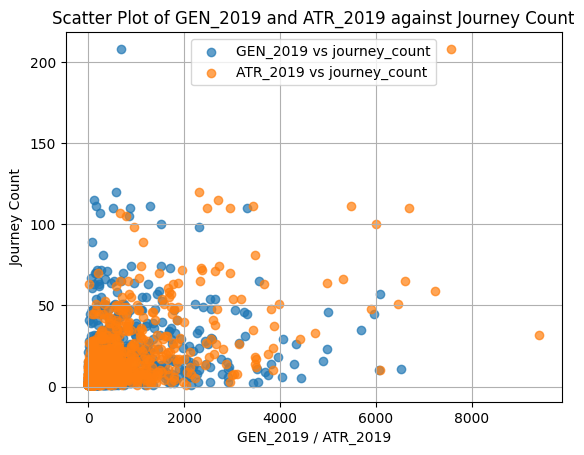

In [6]:
# Explore validity of the data:
# Check x,y plot of 'GEN_2019' and 'ATR_2019' against 'journey_count' in zat_data_merged
import matplotlib.pyplot as plt
plt.scatter(zat_data_merged['GEN_2019'], zat_data_merged['journey_count'], label='GEN_2019 vs journey_count', alpha=0.7)
plt.scatter(zat_data_merged['ATR_2019'], zat_data_merged['journey_count'], label='ATR_2019 vs journey_count', alpha=0.7)
plt.xlabel('GEN_2019 / ATR_2019')
plt.ylabel('Journey Count')
plt.title('Scatter Plot of GEN_2019 and ATR_2019 against Journey Count')
plt.legend()
plt.grid(True)
plt.show()



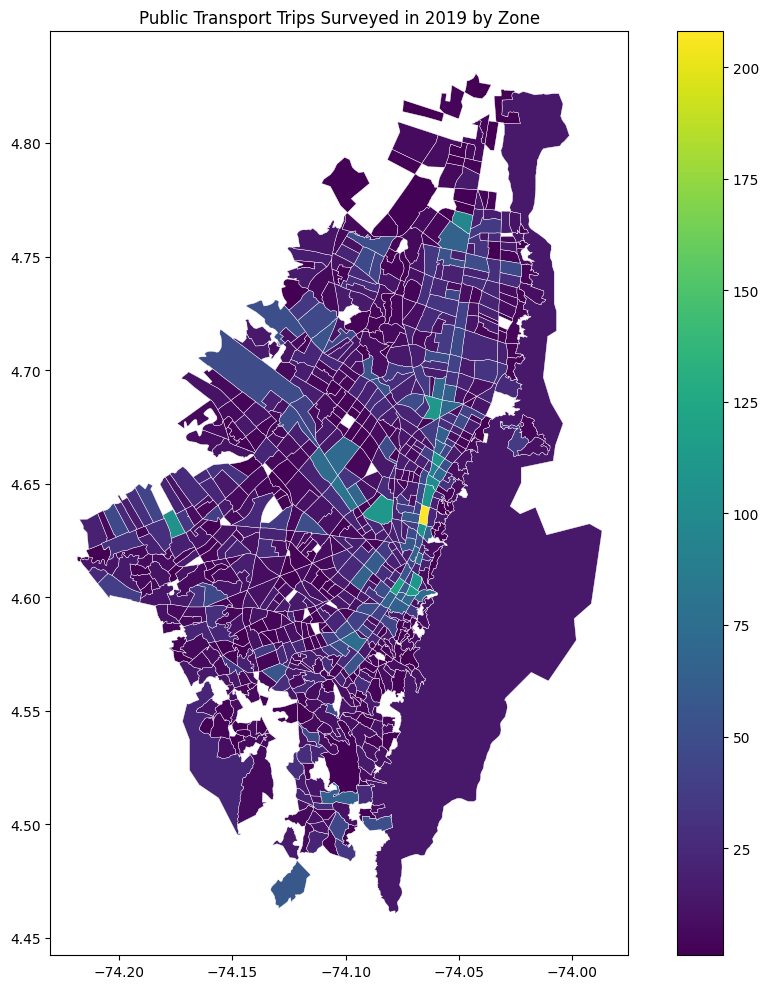

In [7]:
# 1. Visualize ZAT zones in encuesta data
output_path_figures = '../figures'
fig, ax = plt.subplots(figsize=(10, 10))
zat_data_merged[zat_data_merged.journey_count > 0].plot(column='journey_count', 
              #cmap='OrRd',
              edgecolor='white',
              linewidth=0.3, 
              legend=True,
              ax=ax)
ax.set_title('Public Transport Trips Surveyed in 2019 by Zone')
plt.tight_layout()
# plt.savefig(f'{output_path_figures}/zat_trips_2019.png')

# Interactive map with folium

In [10]:
zat_data_merged.columns

Index(['ZAT', 'GEN_2019', 'ATR_2019', 'GEN_2026', 'ATR_2026', 'GEN_2030',
       'ATR_2030', 'VIAJ_MUJ', 'VIAJ_HOM', 'VIAJ_TRANS', 'PRC_MUJ', 'INGRESO',
       'COSTO_PUT', 'PRC_ING', 'T_PUT', 'VIAJ_TRAB', 'geometry', 'NOMMun',
       'UTAM', 'zat_origen', 'journey_count'],
      dtype='object')

In [17]:
import folium
column_choice_1 = 'GEN_2019'
column_choice_2 = 'ATR_2019'
# Make sure the CRS is correct for web mapping (WGS 84)
zat_data_merged = zat_data_merged.to_crs(epsg=4326)

# Create an interactive map
m = folium.Map(location=[4.6097, -74.0817], zoom_start=11)  # Coordinates for Bogotá

# Add choropleth layer for journey_count
journey_count_layer = folium.Choropleth(
    geo_data=zat_data_merged,
    name='Survey Trips',
    data=zat_data_merged,
    columns=['ZAT', 'journey_count'],
    key_on='feature.properties.ZAT',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Public Transport Trips surveyed in 2019'
).add_to(m)

# Add choropleth layer for GEN_2019
gen_2019_layer = folium.Choropleth(
    geo_data=zat_data_merged,
    name='Generated Trips',
    data=zat_data_merged,
    columns=['ZAT', column_choice_1],
    key_on='feature.properties.ZAT',
    fill_color='PuBu',  # Different color scheme
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Trips Generated in 2019'
).add_to(m)

# Add choropleth layer for ATR_2019
gen_2019_layer = folium.Choropleth(
    geo_data=zat_data_merged,
    name='Attracted Trips',
    data=zat_data_merged,
    columns=['ZAT', column_choice_2],
    key_on='feature.properties.ZAT',
    fill_color='PuBu',  # Different color scheme
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Trips Attracted in 2019'
).add_to(m)

# Add hover functionality
style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}

folium.features.GeoJson(
    zat_data_merged,
    style_function=style_function,
    control=False,
    highlight_function=highlight_function,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['ZAT', column_choice_1, column_choice_2, 'journey_count', 'ATR_2019', 'INGRESO', 'COSTO_PUT'],
        aliases=['Zone ID', 'Trips Generated', 'Trips Attracted', 'trips surveyed', 'Trips Attracted', 'Avg Income', 'Transport Cost'],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
).add_to(m)

# Add layer control
folium.LayerControl().add_to(m)

# Save the map
m.save('../figures/folium/zat_interactive_map.html')

In [18]:
display(m)